# Deep submesoscales in 1/100°?

Are there submesoscale features in the deep eq ocean? Do we resolve them with coarser vertical spacing?

May be some fronty things close to the equator, but our vertical resolution gets coarse (≈40m at 500m depth), so we may not be resolving things properly

## Setup

In [ ]:
%config InlineBackend.figure_format = "retina"

In [ ]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import dask
import distributed
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import seawater as sw

import cf_xarray

import dcpy
import facetgrid
import xarray as xr

# import xmitgcm

# import pump

mpl.rcParams["savefig.dpi"] = 300
mpl.rcParams["savefig.bbox"] = "tight"
mpl.rcParams["figure.dpi"] = 140

xr.set_options(keep_attrs=True)

In [ ]:
cluster = distributed.LocalCluster(
    n_workers=24,
    processes=True,
    threads_per_worker=1,
    local_directory="/home/dcherian/.dask_worker/",
    dashboard_address=":9999",
    memory_limit="10GB",
)
cluster

In [ ]:
client = distributed.Client(cluster)

## Read data

In [ ]:
dirname = '/home/dcherian/pump/TPOS_MITgcm_HR/'

In [ ]:
ds = xr.open_mfdataset(
    f"{dirname}/cmpr_*.nc",
    parallel=True,
    data_vars="minimal",
    coords="minimal",
    compat="override",
    chunks={"longitude": 1500, "latitude": 240}
)

## Ro

In [ ]:
f = dcpy.oceans.coriolis(ds.latitude)
vor = ds.v.differentiate("longitude")/110e3 - ds.u.differentiate("latitude")/105e3
Ro = vor / f
Ro.attrs["long_name"] = "$Ro = ζ/f$"
Ro

,Array,Chunk
Bytes,1.88 TB,266.40 MB
Shape,"(141, 185, 2400, 7500)","(1, 185, 240, 1500)"
Count,165273 Tasks,7050 Chunks
Type,float32,numpy.ndarray


Scott's $Ro$

\begin{equation}
    Ro = \frac{|ζ|}{|ζ| + |f|}
\end{equation}

In [ ]:
sRo = np.abs(vor) / (np.abs(vor) + np.abs(f))
sRo.attrs["long_name"] = "$Ro = |ζ| / (|ζ| + |f|)$"

## $u$ lat-depth sections

In [ ]:
kwargs = dict(
    robust=True,
    vmin=0,
    vmax=0.8,
    cmap=mpl.cm.Spectral_r,
    cbar_kwargs={"orientation": "horizontal"},
)

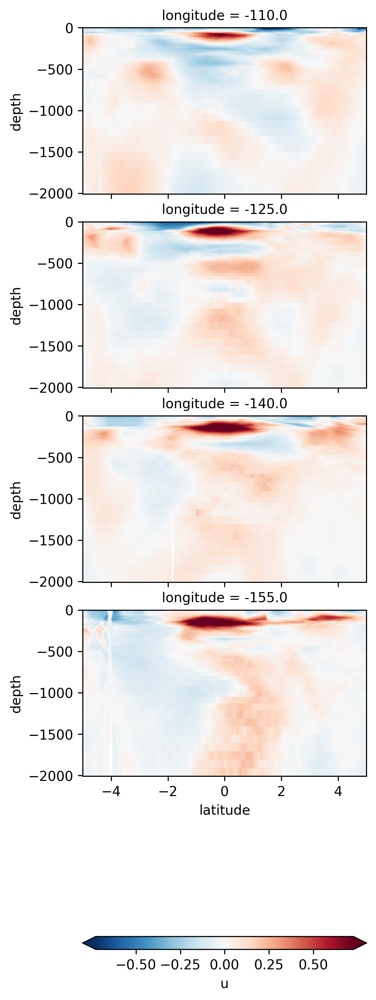

In [ ]:
ds.u.sel(longitude=[-110, -125, -140, -155], method="nearest").sel(
    latitude=slice(-5, 5), depth=slice(-2000)
).isel(time=50).plot(
    y="depth",
    x="latitude",
    row="longitude",
    robust=True,
    cbar_kwargs={"orientation": "horizontal"},
)

## Scott $Ro$ maps

Looks more "fronty" at depth

In [ ]:
subset = sRo.sel(latitude=slice(-10, 10), longitude=slice(-155, -110))

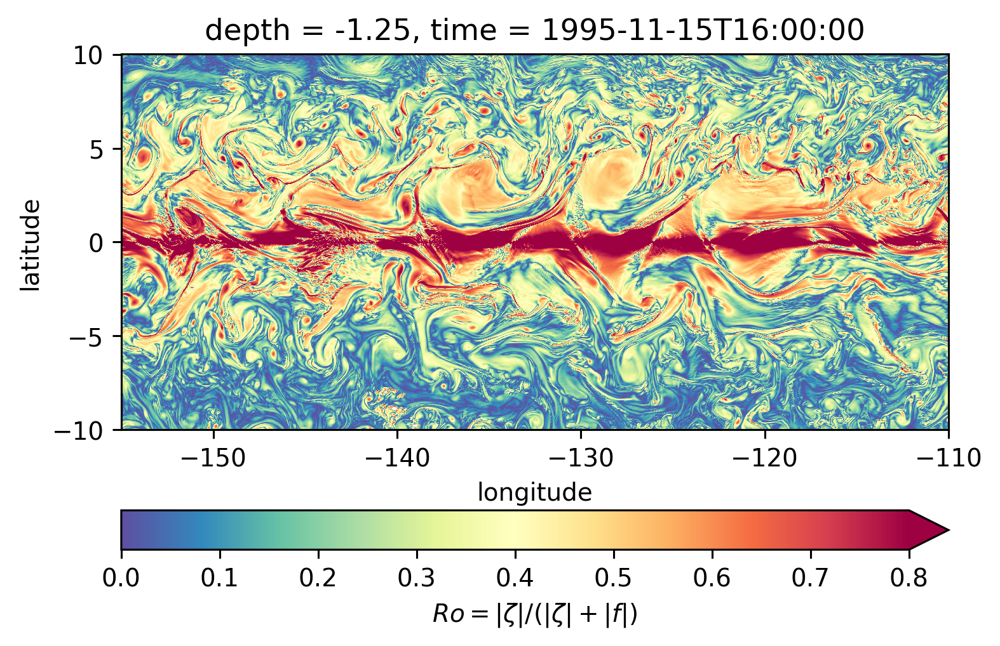

In [ ]:
subset.isel(time=50).sel(depth=0, method="nearest").plot(**kwargs)

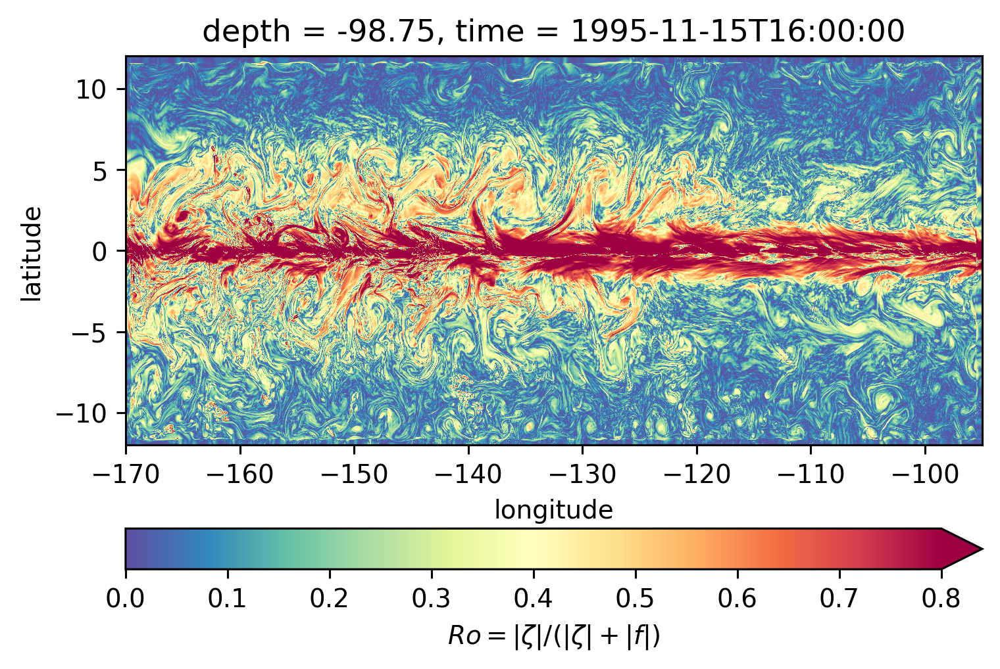

In [ ]:
sRo.isel(time=50).sel(depth=-100, method="nearest").plot(**kwargs)

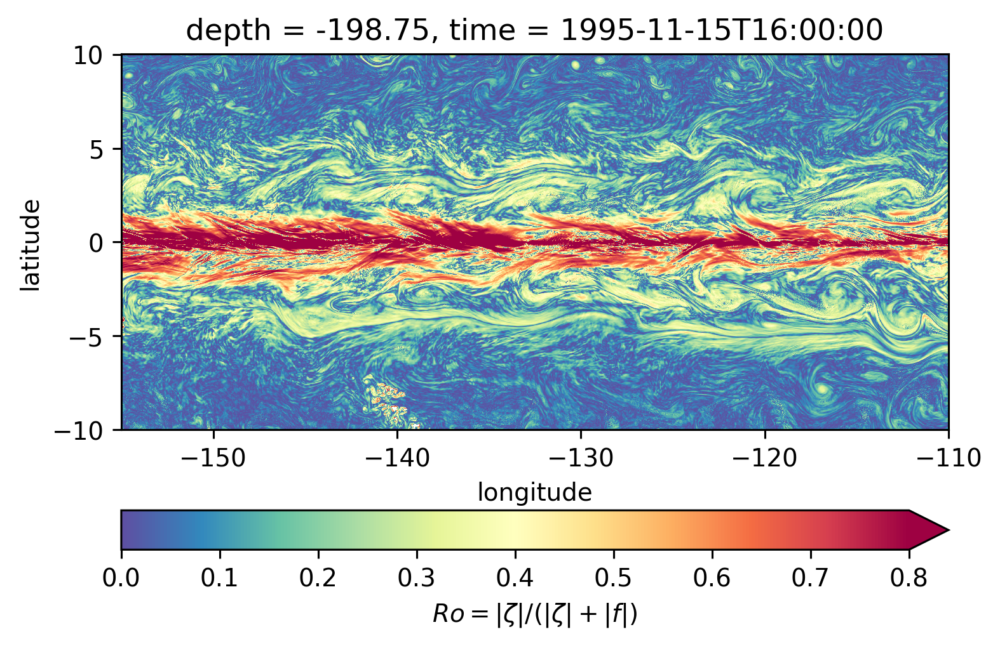

In [ ]:
subset.isel(time=50).sel(depth=-200, method="nearest").plot(**kwargs)

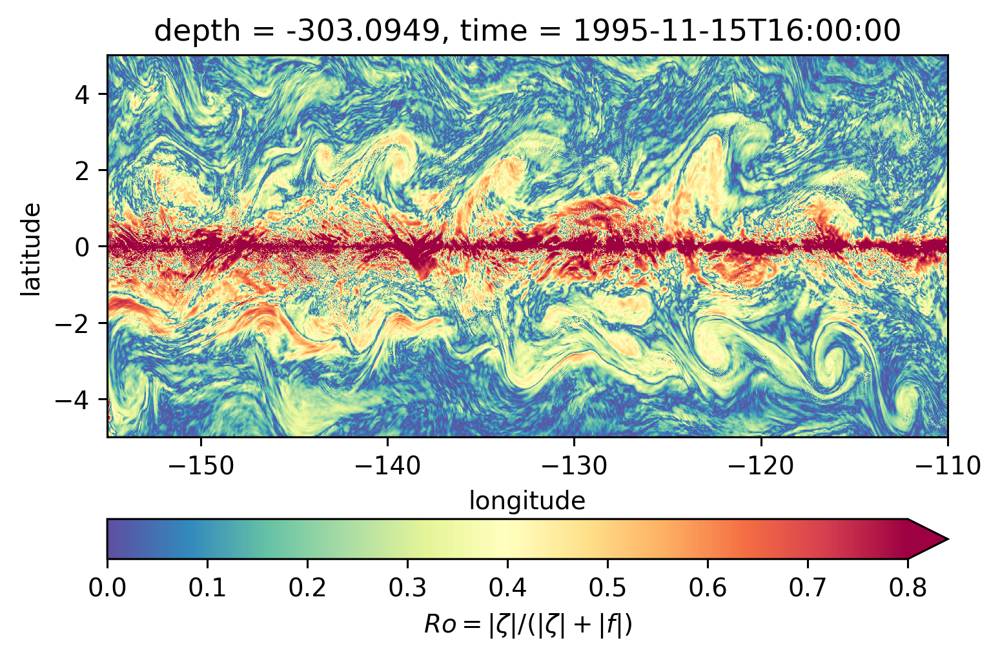

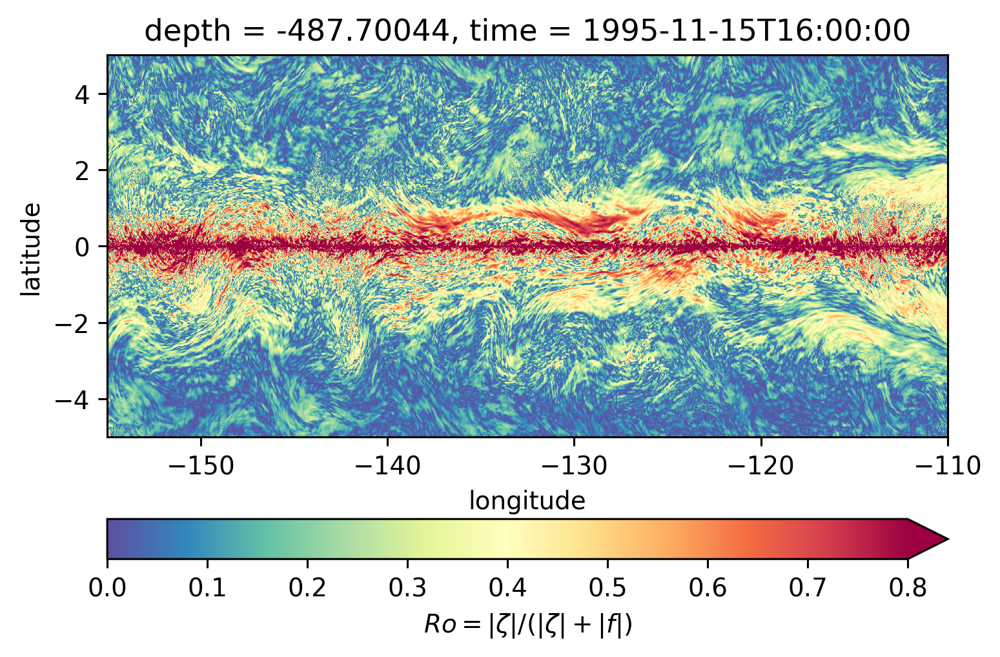

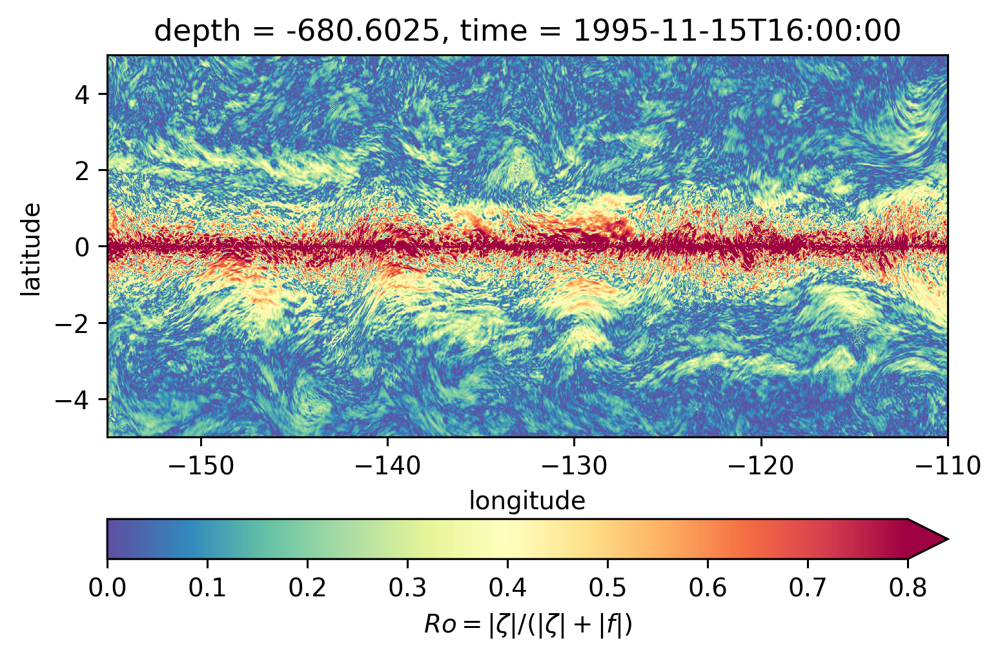

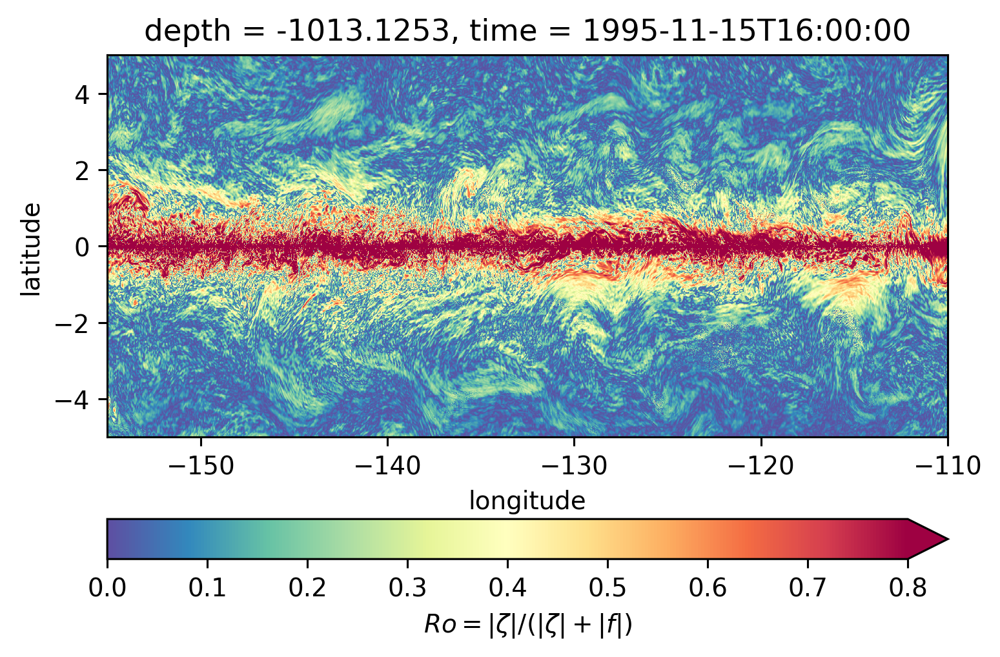

In [ ]:
for depth in [-300, -500, -700, -1000]:
    plt.figure()
    subset.isel(time=50).sel(depth=depth, method="nearest").plot(ylim=(-5, 5), **kwargs)

## Ro maps at depth

/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/xarray/core/indexing.py:1375: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  value = value[(slice(None),) * axis + (subkey,)]
/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/xarray/core/indexing.py:1375: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexe

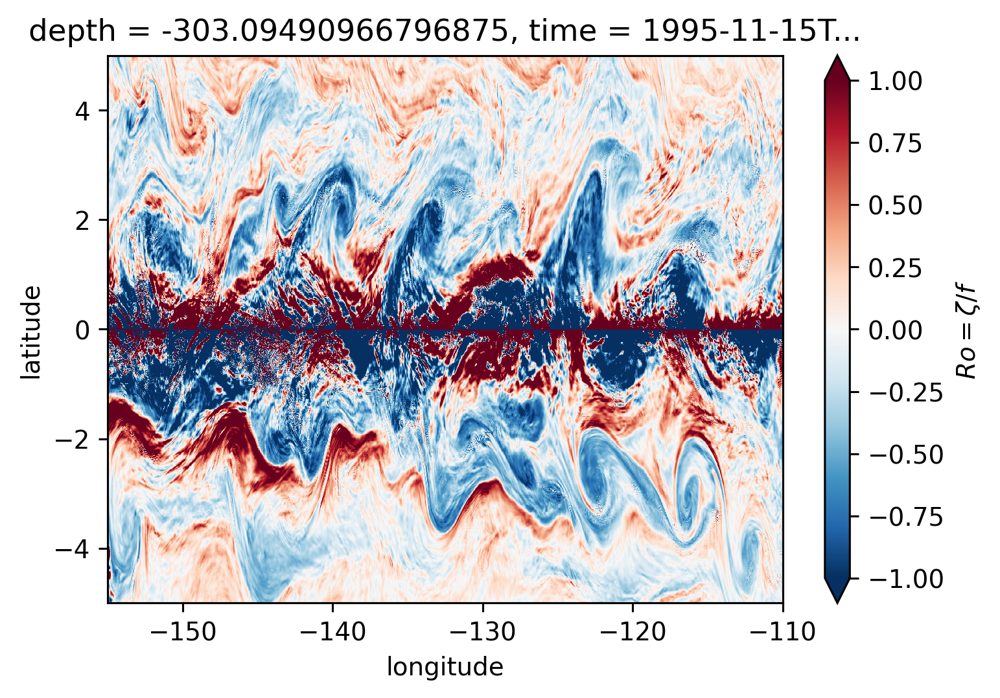

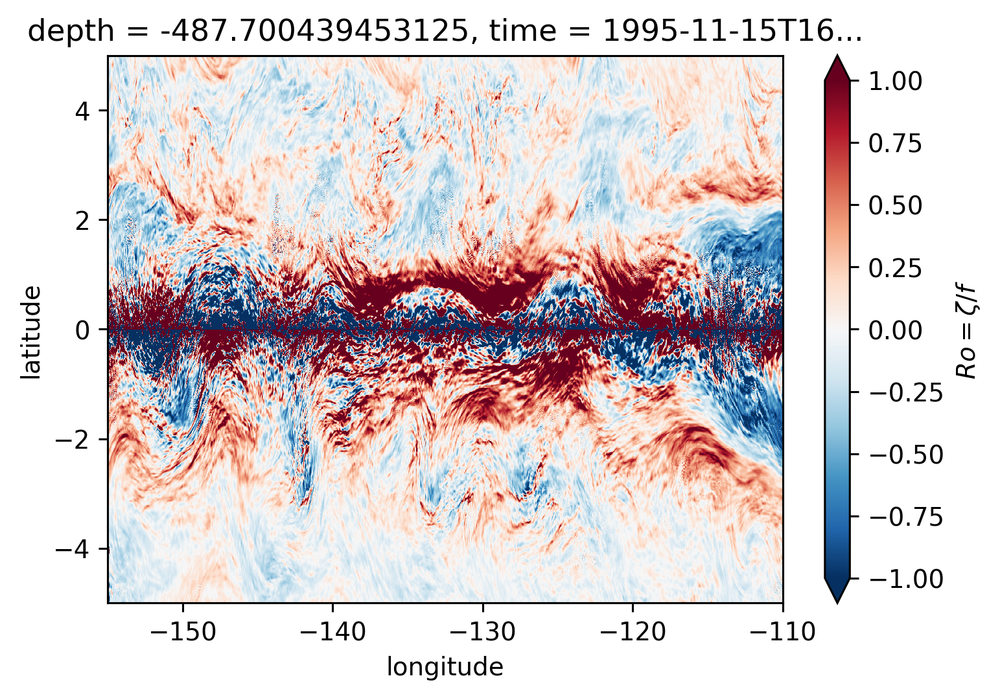

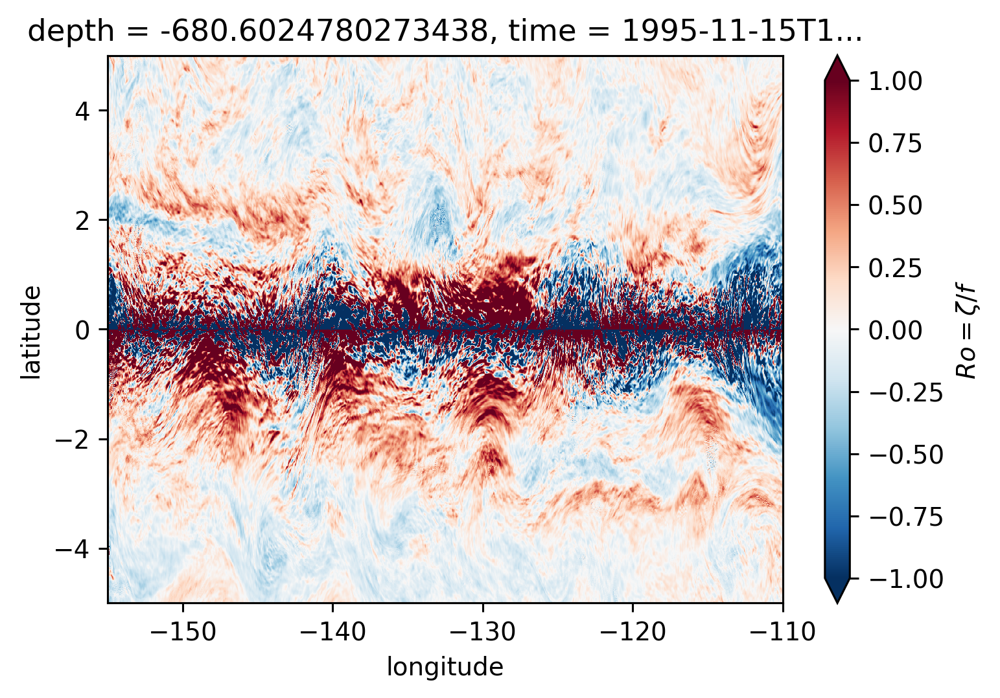

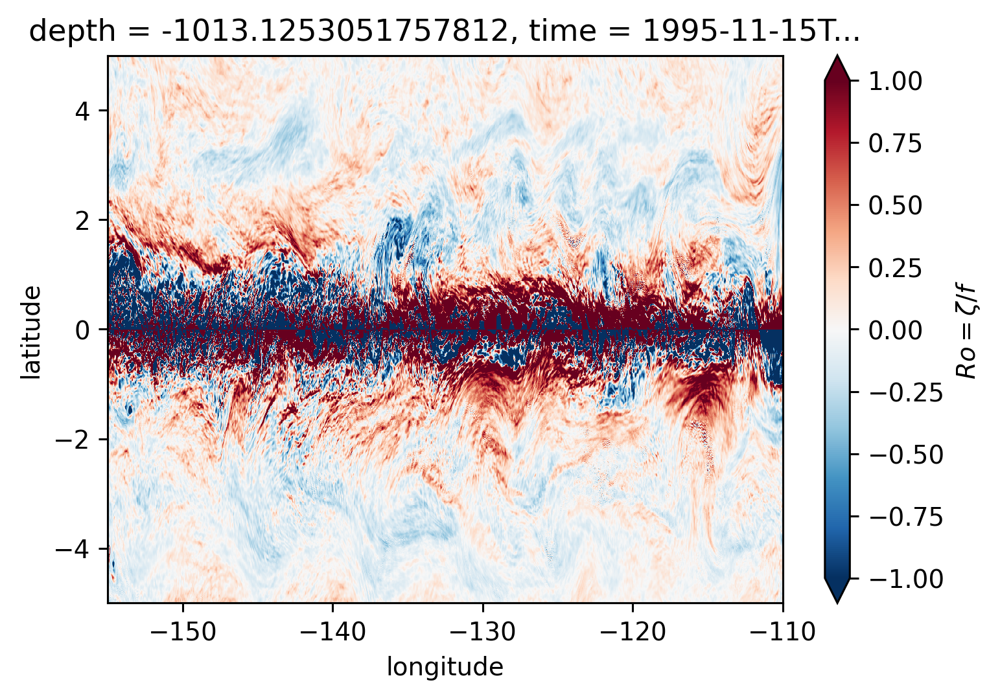

In [ ]:
for depth in [-300, -500, -700, -1000]:
    plt.figure()
    Ro.reindex_like(subset).isel(time=50).sel(depth=depth, method="nearest").plot(
        ylim=(-5, 5),
        cmap=mpl.cm.RdBu_r,
        vmin=-1,
        vmax=1,
    )

## Ro Lat-depth plots

There may be some interesting things in 1°S-1°N, but our vertical resolution is coarse below 250m

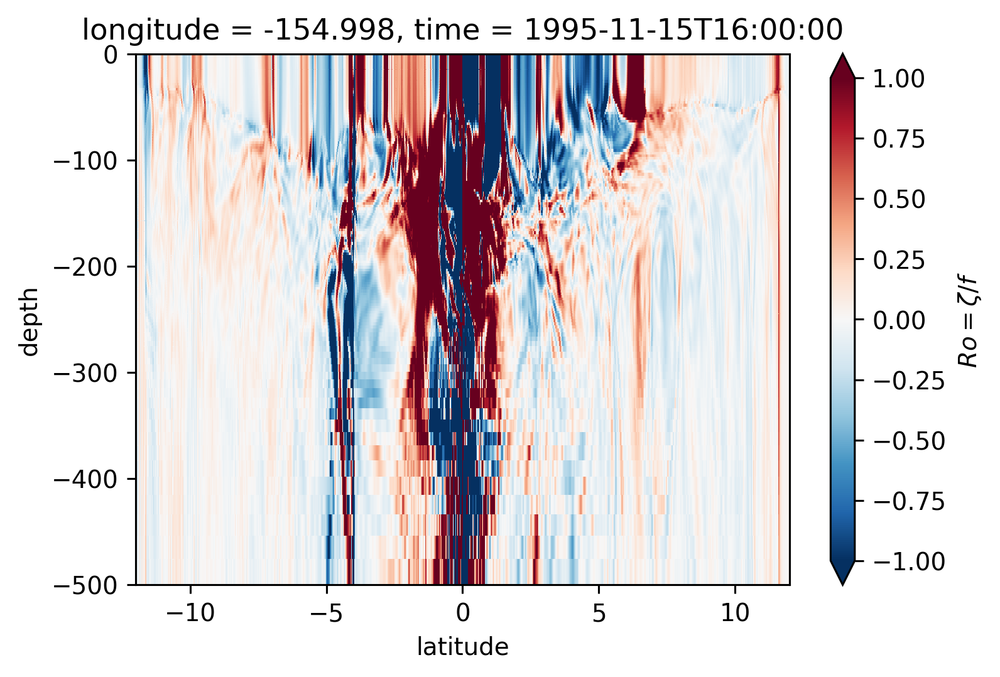

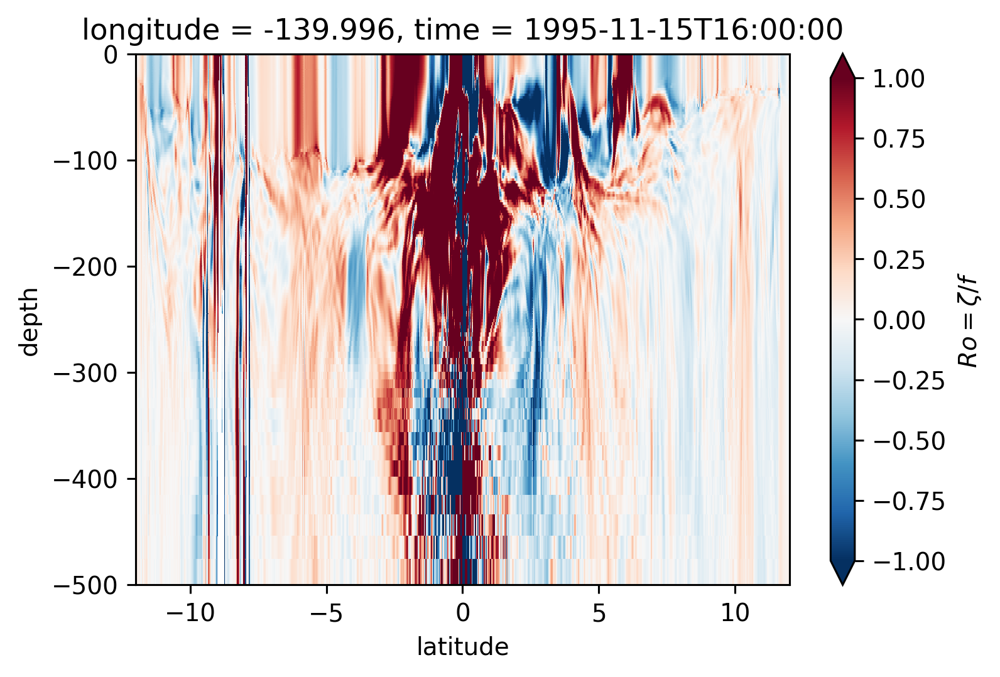

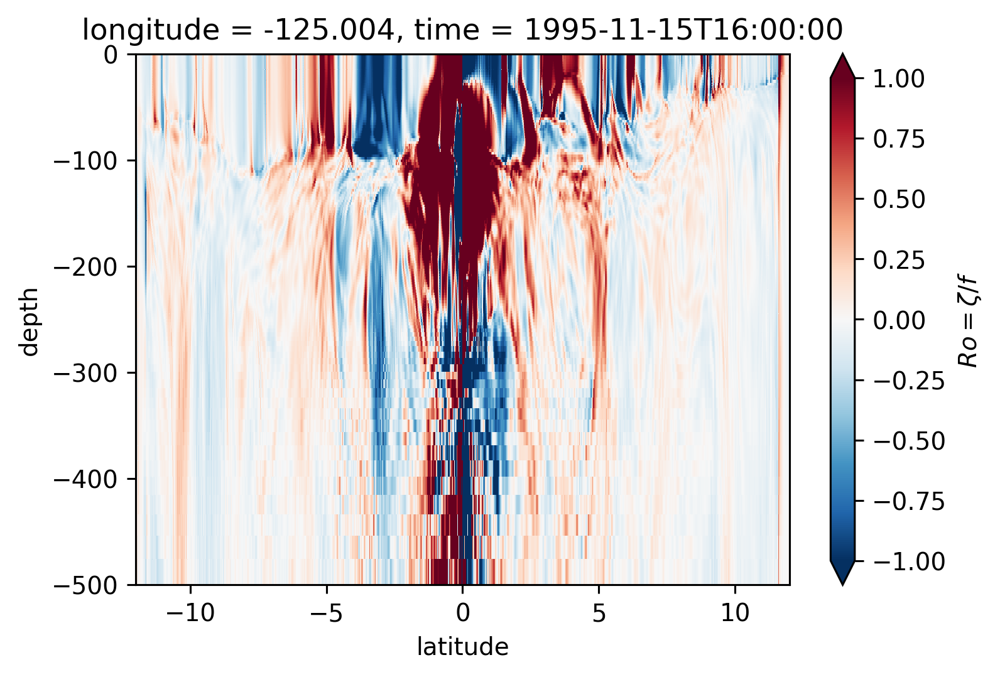

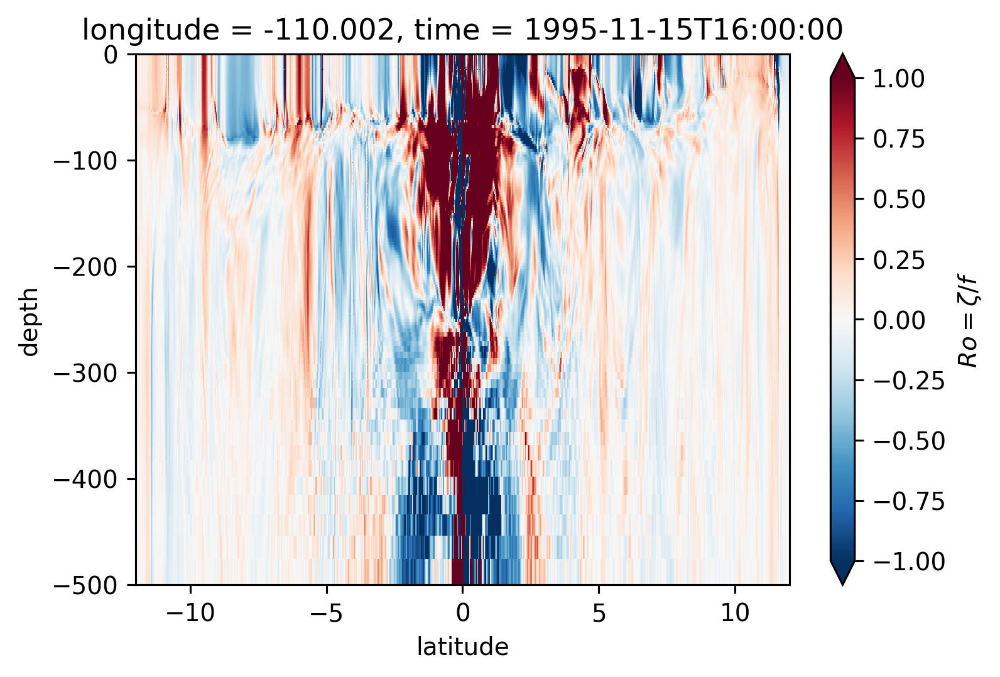

In [ ]:
for longitude in [-155, -140, -125, -110]:
    plt.figure()
    Ro.isel(time=50).sel(longitude=longitude, method="nearest").plot(
        ylim=(-500, 0), vmin=-1, vmax=1, cmap=mpl.cm.RdBu_r, y="depth"
    )

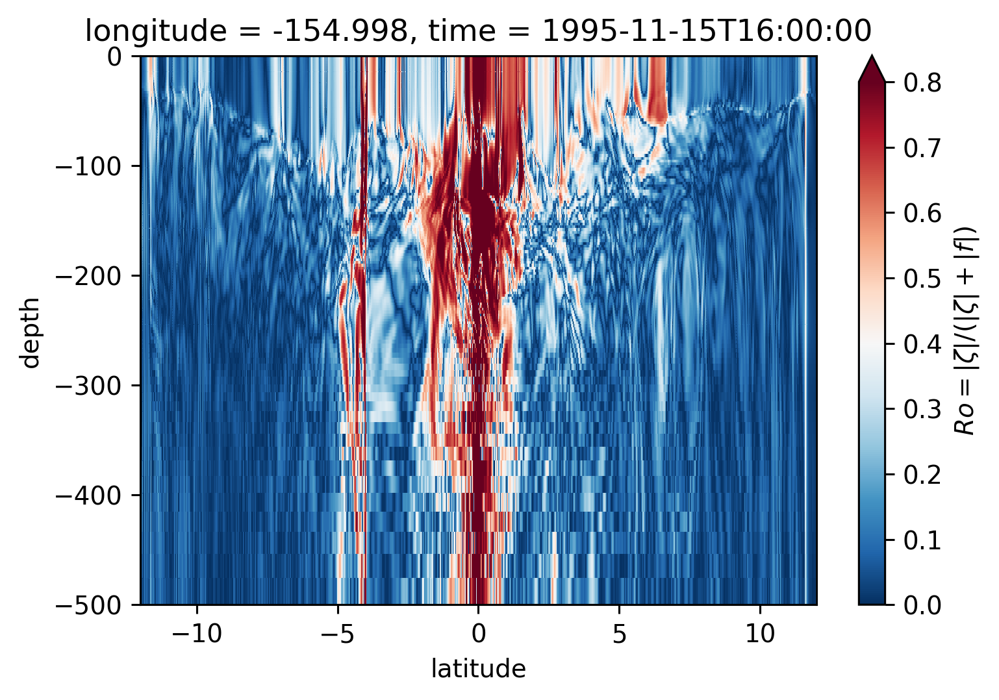

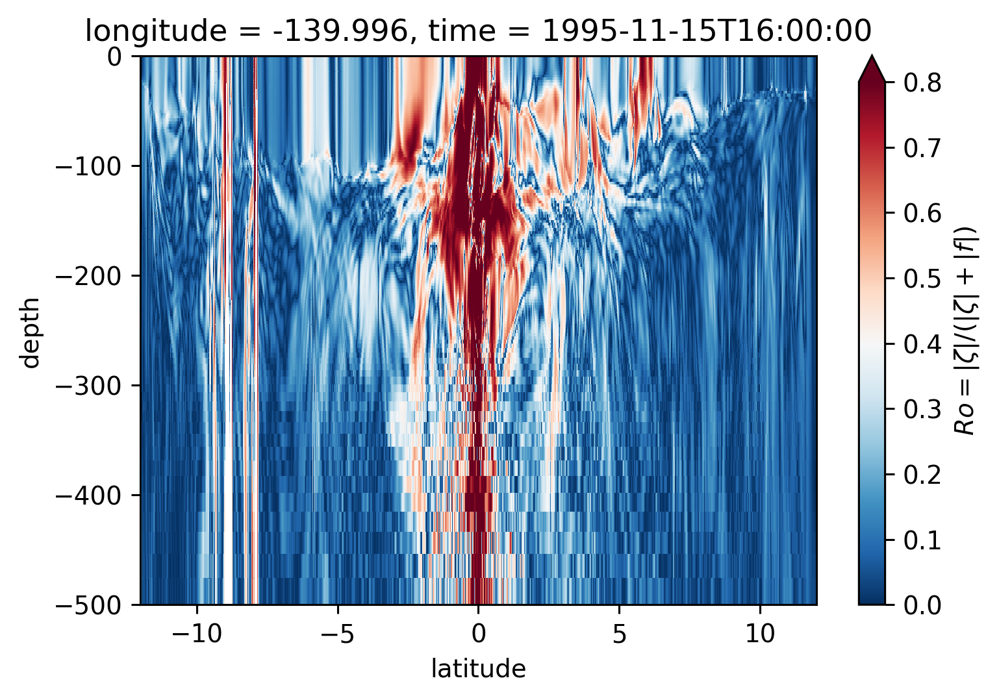

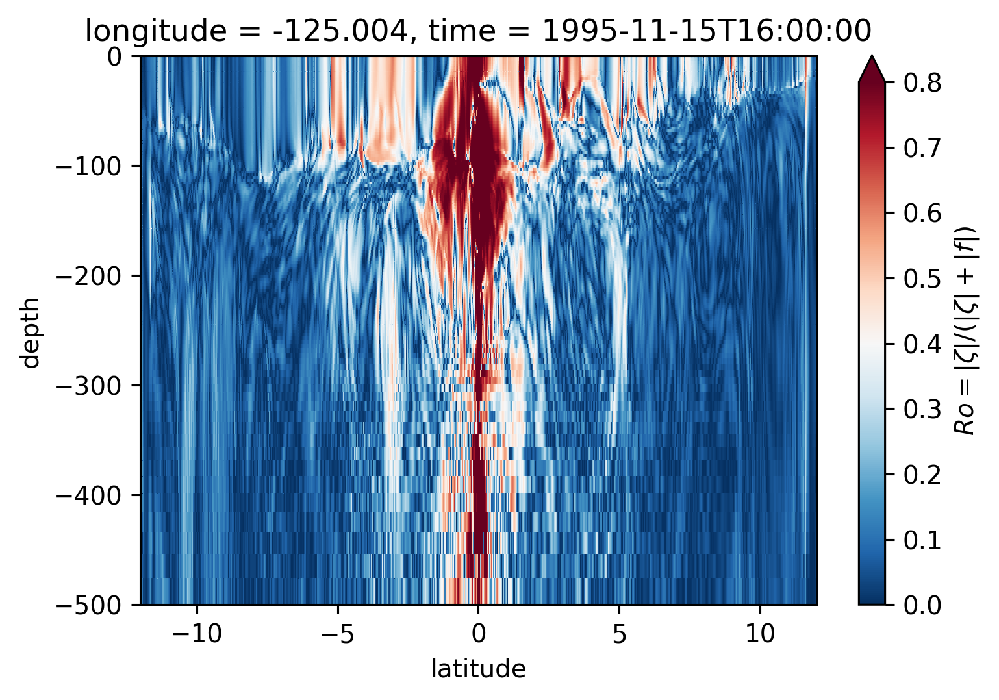

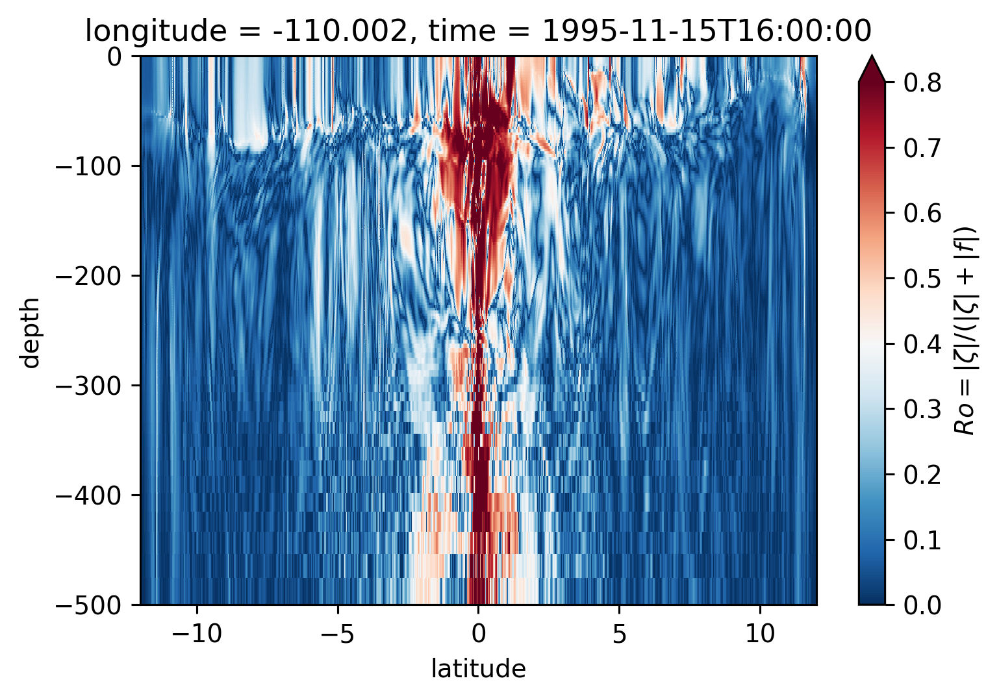

In [ ]:
for longitude in [-155, -140, -125, -110]:
    plt.figure()
    sRo.isel(time=50).sel(longitude=longitude, method="nearest").plot(
        ylim=(-500, 0), vmin=0, vmax=0.8, cmap=mpl.cm.RdBu_r, y="depth"
    )